### Loading the data structure that includes the ground truth values, prediction intervals, and Intersection over Union (IoU) scores.

In [2]:
import json
from google.colab import drive
import shutil
import tarfile
import os

drive.mount('/content/drive')

with open('/content/drive/My Drive/Colab Notebooks/data.txt', 'r') as file:
    data_in = json.load(file)

# Drop queries if the duration of the predicted interval is > 10s.
# This is done due to limited computational resources and in order to reduce
# computational times when cutting videos and processing them by LLaVA.
data = [d for d in data_in if d['pred'][1] - d['pred'][0] <= 10]
# Select the first 50 NLQ queries
data = data[:50]

# Add the manually annotated ground truths stored in annotated_gt.txt
with open('/content/drive/My Drive/Colab Notebooks/annotated_gt.txt', 'r') as file:
    # Read lines from the file
    lines = file.readlines()
    # Iterate over each line
    index = 0
    for line in lines:
        # Strip whitespace characters (like newline) from the beginning and end of the line
        stripped_line = line.strip()
        # Check if the line is not empty
        if stripped_line:
            data[index]['annotated_gt'] = stripped_line
            index += 1

for el in data:
  print(el['query'], el['annotated_gt'])

Mounted at /content/drive
What color is the dish brush The dish brush is sky blue
What color is the fuel tank lid i closed The fuel tank I closed is grey
where did i put my phone? I put the phone on the kitchen countertop
Who was with me when I pulled the lawnmower? A man dressed in grey was with me when I pulled the lawnmower
What chopping board did I wash? I washed the white chopping board
Where was the plate before I took it? The plate was in the cupboard before I took it
Where was the egg before I picked it? The egg was in the fridge before I picked it
who did I talk to in  the house? I talked to a guy wearing a striped shirt
How many plates did i take from the top shelf? I took two plates from the top shelf
Where is round brush before picked? The round bruss was on the floor before I picked it
Who did I interact with when I was walking out of the clothing store.  I interacted with a woman with black hair when I was walking out of the clothing store
where was the phone before I pic

In [4]:
%%bash
pip install boto3

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.2/139.2 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 99.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.2/84.2 kB 10.6 MB/s eta 0:00:00


### Fetching the videos that correspond to the video_uids in the data structure.

In [6]:
import pandas as pd
import logging
import boto3
from botocore.exceptions import NoCredentialsError
import os

# Initialize a boto3 client with AWS credentials
s3_client = boto3.client(
    's3',
    aws_access_key_id='access_key',
    aws_secret_access_key='secret_key'
)

# Download manifest.csv
s3_client.download_file('ego4d-consortium-sharing', 'public/v1/full_scale/manifest.csv', '/content/manifest.csv')

# Download a video given the bucket name, the key and the output path
def download_from_s3(bucket_name, key, local_path):
    try:
        s3_client.download_file(bucket_name, key, local_path)
        print(f"Downloaded {local_path}")
    except NoCredentialsError:
        print("Credentials not available")
    except Exception as e:
        print(f"Failed to download {local_path}: {str(e)}")


# Download videos from a list of video_uid through manifest.csv
def download_videos(csv_path, data, download_directory):
    video_uids = [d['video_uid'] for d in data]
    """Download all videos listed in the CSV file that match the given video UIDs."""
    df = pd.read_csv(csv_path)
    # Keep only the videos that are in the list
    filtered_df = df[df['video_uid'].isin(video_uids)]
    for index, row in filtered_df.iterrows():
        bucket_name = row['path'].split('/')[2]
        key = '/'.join(row['path'].split('/')[3:])
        local_path = os.path.join(download_directory, f"{row['video_uid']}.mp4")
        download_from_s3(bucket_name, key, local_path)

    # Add the path to the video in the data structure
    for d in data:
      d['video_path'] = os.path.join(download_directory, f"{d['video_uid']}.mp4")

csv_path = '/content/manifest.csv'
download_directory = '/content/downloaded_videos'

# Check if the download directory doesn't exist, then create it
if not os.path.exists(download_directory):
    os.makedirs(download_directory)

download_videos(csv_path, data, download_directory)

Downloaded /content/downloaded_videos/e0c4d2c7-fd50-4c50-b40e-e1eda4a5708b.mp4
Downloaded /content/downloaded_videos/51fc62f8-00f4-44e3-af9c-7ebb63da6c3d.mp4
Downloaded /content/downloaded_videos/404cc1c1-f7a0-4e16-9a39-b8e2d5d9ae59.mp4
Downloaded /content/downloaded_videos/243e800d-fc75-473d-b944-a95844e13a78.mp4
Downloaded /content/downloaded_videos/fb7cc35d-3272-44a4-b8f2-15cd24fa345b.mp4
Downloaded /content/downloaded_videos/477feff8-a1ff-4f43-b726-273ca0fa47e9.mp4
Downloaded /content/downloaded_videos/bd3a319e-0573-4802-a6d1-6d89910098e8.mp4
Downloaded /content/downloaded_videos/8698a0ea-f434-49f9-a8e4-45220e5d4b2c.mp4
Downloaded /content/downloaded_videos/b3ba6f28-2506-4121-ad08-c5b96b410a1f.mp4
Downloaded /content/downloaded_videos/5fce50cf-ebc5-4c09-8704-20c48fe42c7e.mp4
Downloaded /content/downloaded_videos/8ff25fe1-3a42-4449-bd91-b3ac2adf9143.mp4
Downloaded /content/downloaded_videos/603ecf93-d2c1-4611-a690-76afd18935c8.mp4
Downloaded /content/downloaded_videos/115774b6-534d-

### Trim the videos based on the predictions provided by the model.

In [7]:
import subprocess

def extract_video_segment(video_path, start_time, duration, output_path):
    """Extract a specific segment from a video using FFmpeg.

    Args:
        video_path (str): Path to the input video file.
        start_time (str): Start time of the segment to extract in HH:MM:SS format.
        duration (str): Duration of the segment to extract in HH:MM:SS format.
        output_path (str): Path to save the extracted video segment.

    Raises:
        RuntimeError: If FFmpeg command fails.
    """
    command = [
        'ffmpeg',
        '-ss', str(start_time),  # Start time
        '-i', video_path,  # Input file
        '-t', str(duration),  # Duration of the segment
        '-c:v', 'libx264',  # Video codec (re-encode to H.264)
        '-c:a', 'aac',  # Audio codec (re-encode to AAC)
        '-strict', 'experimental',  # Needed for aac
        output_path
    ]

    try:
        result = subprocess.run(command, check=True, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
        print(f"Segment extracted to {output_path}")
    except subprocess.CalledProcessError as e:
        error_message = e.stderr.decode()
        raise RuntimeError(f"Error extracting video segment from {video_path}: {error_message}")

cut_videos_directory = '/content/cut_videos'

if not os.path.exists(cut_videos_directory):
    os.makedirs(cut_videos_directory)

# Assign an incremental id to the segments
video_segment_uid = 0

for d in data:

  input_path = d['video_path']
  output_path = os.path.join('/content/cut_videos/', f'{video_segment_uid}.mp4')
  start_time = d['pred_over_video'][0]
  end_time = d['pred_over_video'][1]
  duration = end_time - start_time
  extract_video_segment(input_path, start_time, duration, output_path)

  d['video_segment_path'] = output_path
  video_segment_uid += 1

Segment extracted to /content/cut_videos/0.mp4
Segment extracted to /content/cut_videos/1.mp4
Segment extracted to /content/cut_videos/2.mp4
Segment extracted to /content/cut_videos/3.mp4
Segment extracted to /content/cut_videos/4.mp4
Segment extracted to /content/cut_videos/5.mp4
Segment extracted to /content/cut_videos/6.mp4
Segment extracted to /content/cut_videos/7.mp4
Segment extracted to /content/cut_videos/8.mp4
Segment extracted to /content/cut_videos/9.mp4
Segment extracted to /content/cut_videos/10.mp4
Segment extracted to /content/cut_videos/11.mp4
Segment extracted to /content/cut_videos/12.mp4
Segment extracted to /content/cut_videos/13.mp4
Segment extracted to /content/cut_videos/14.mp4
Segment extracted to /content/cut_videos/15.mp4
Segment extracted to /content/cut_videos/16.mp4
Segment extracted to /content/cut_videos/17.mp4
Segment extracted to /content/cut_videos/18.mp4
Segment extracted to /content/cut_videos/19.mp4
Segment extracted to /content/cut_videos/20.mp4
Se

### Pass the video segments along with the related questions into Video-LLaVa for processin

In [8]:
#Set up the Video-LLaVA environment
%%bash

git clone https://github.com/PKU-YuanGroup/Video-LLaVA
cd Video-LLaVA
conda create -n videollava python=3.10 -y
conda activate videollava
pip install --upgrade pip  # enable PEP 660 support
pip install -e .
pip install -e ".[train]"
pip install flash-attn --no-build-isolation
pip install decord opencv-python git+https://github.com/facebookresearch/pytorchvideo.git@28fe037d212663c6a24f373b94cc5d478c8c1a1d
pip install git+https://github.com/PKU-YuanGroup/Video-LLaVA.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 43.7 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 24.1.2
    Uninstalling pip-24.1.2:
      Successfully uninstalled pip-24.1.2
Obtaining file:///content/Video-LLaVA
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Checking if build backend supports build_editable: started
  Checking if build backend supports build_editable: finished with status 'done'
  Getting requirements to build editable: started
  Getting requirements to build editable: finished with status 'done'
  Preparing editable metadata (pyproject.toml): started
  Preparing editable metadata (pyproject.toml): finished with status 'done'
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
INFO: pip is looking at multiple versions of mdit-py-plugins to determine which version is compatible with other requirements. This could take a

Cloning into 'Video-LLaVA'...
bash: line 4: conda: command not found
bash: line 5: conda: command not found
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 1.4.20 requires pydantic>=2.7.0, but you have pydantic 1.10.21 which is incompatible.
mlxtend 0.23.3 requires scikit-learn>=1.3.1, but you have scikit-learn 1.2.2 which is incompatible.
sentence-transformers 3.3.1 requires transformers<5.0.0,>=4.41.0, but you have transformers 4.31.0 which is incompatible.
torchaudio 2.5.1+cu121 requires torch==2.5.1, but you have torch 2.0.1 which is incompatible.
langchain 0.3.15 requires pydantic<3.0.0,>=2.7.4, but you have pydantic 1.10.21 which is incompatible.
google-genai 0.3.0 requires pydantic<3.0.0dev,>=2.0.0, but you have pydantic 1.10.21 which is incompatible.
google-genai 0.3.0 requires websockets<15.0dev,>=13.0, but you have websockets 11.0.3 whi

In [9]:
import shutil

# Remove the original videos in order to deal with the free Colab disk space limit
# since LLaVa model size is 15+ GB
shutil.rmtree('/content/downloaded_videos')

Load librariers and the pretrained model

In [10]:
import torch
from videollava.constants import IMAGE_TOKEN_INDEX, DEFAULT_IMAGE_TOKEN
from videollava.conversation import conv_templates, SeparatorStyle
from videollava.model.builder import load_pretrained_model
from videollava.utils import disable_torch_init
from videollava.mm_utils import tokenizer_image_token, get_model_name_from_path, KeywordsStoppingCriteria

model_path = 'LanguageBind/Video-LLaVA-7B'
cache_dir = 'cache_dir'
device = 'cuda'
load_4bit, load_8bit = True, False
model_name = get_model_name_from_path(model_path)
tokenizer, model, processor, _ = load_pretrained_model(model_path, None, model_name, load_8bit, load_4bit, device=device, cache_dir=cache_dir)

[2025-01-25 02:47:35,572] [INFO] [real_accelerator.py:110:get_accelerator] Setting ds_accelerator to cuda (auto detect)


/usr/local/lib/python3.11/dist-packages/torchvision/transforms/_functional_video.py:6: UserWarning: The 'torchvision.transforms._functional_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms.functional' module instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/transforms/_transforms_video.py:22: UserWarning: The 'torchvision.transforms._transforms_video' module is deprecated since 0.12 and will be removed in the future. Please use the 'torchvision.transforms' module instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/transforms/functional_tensor.py:5: UserWarning: The torchvision.transforms.functional_tensor module is deprecated in 0.15 and will be **removed in 0.17**. Please don't rely on it. You probably just need to use APIs in torchvision.transforms.functional or in torchvision.transforms.v2.functional.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/huggingfa

tokenizer_config.json:   0%|          | 0.00/749 [00:00<?, ?B/s]

tokenizer.model:   0%|          | 0.00/500k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/438 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/1.09k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/150k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/9.98G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/4.96G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.61k [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

Some weights of the model checkpoint at LanguageBind/Video-LLaVA-7B were not used when initializing LlavaLlamaForCausalLM: ['model.image_tower.image_tower.encoder.layers.9.layer_norm2.bias', 'model.video_tower.video_tower.encoder.layers.11.mlp.fc2.bias', 'model.image_tower.image_tower.encoder.layers.15.self_attn.out_proj.weight', 'model.image_tower.image_tower.encoder.layers.10.self_attn.k_proj.weight', 'model.video_tower.video_tower.encoder.layers.13.temporal_attn.k_proj.bias', 'model.image_tower.image_tower.encoder.layers.2.layer_norm1.weight', 'model.video_tower.video_tower.encoder.layers.22.temporal_layer_norm1.bias', 'model.image_tower.image_tower.encoder.layers.9.self_attn.q_proj.bias', 'model.video_tower.video_tower.encoder.layers.11.self_attn.q_proj.bias', 'model.image_tower.image_tower.embeddings.position_embedding.weight', 'model.image_tower.image_tower.encoder.layers.13.self_attn.out_proj.bias', 'model.video_tower.video_tower.pre_layrnorm.weight', 'model.video_tower.video_to

generation_config.json:   0%|          | 0.00/162 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/1.71G [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/2.11G [00:00<?, ?B/s]

###Provide the questions and their corresponding video segments to LLaVa for generating natural language responses.

In [11]:
# The function returns the answer in natural language given a video and a corresponding question
def get_nl_answer(video_path, question):
    disable_torch_init()
    model_path = 'LanguageBind/Video-LLaVA-7B'
    cache_dir = 'cache_dir'
    device = 'cuda'
    load_4bit, load_8bit = True, False
    model_name = get_model_name_from_path(model_path)
    video_processor = processor['video']
    conv_mode = "llava_v1"
    conv = conv_templates[conv_mode].copy()
    roles = conv.roles

    video_tensor = video_processor(video_path, return_tensors='pt')['pixel_values']
    if type(video_tensor) is list:
        tensor = [video.to(model.device, dtype=torch.float16) for video in video_tensor]
    else:
        tensor = video_tensor.to(model.device, dtype=torch.float16)

    #print(f"{roles[1]}: {question}")
    question = ' '.join([DEFAULT_IMAGE_TOKEN] * model.get_video_tower().config.num_frames) + '\n' + question
    conv.append_message(conv.roles[0], question)
    conv.append_message(conv.roles[1], None)
    prompt = conv.get_prompt()
    input_ids = tokenizer_image_token(prompt, tokenizer, IMAGE_TOKEN_INDEX, return_tensors='pt').unsqueeze(0).cuda()
    stop_str = conv.sep if conv.sep_style != SeparatorStyle.TWO else conv.sep2
    keywords = [stop_str]
    stopping_criteria = KeywordsStoppingCriteria(keywords, tokenizer, input_ids)

    with torch.inference_mode():
        output_ids = model.generate(
            input_ids,
            images=tensor,
            do_sample=True,
            temperature=0.1,
            max_new_tokens=1024,
            use_cache=True,
            stopping_criteria=[stopping_criteria])

    outputs = tokenizer.decode(output_ids[0, input_ids.shape[1]:]).strip()
    return outputs.split("<")[0]

for d in data:

  video_segment_path = d['video_segment_path']
  question = d['query']

  try:
    d['LLaVa_answer'] = get_nl_answer(video_segment_path, question)
  except Exception as e:
    print(e)

### Evaluate the quality of the answers generated by LLaVA.

In [12]:
%%bash

pip install nltk
pip install rouge

In [13]:
import nltk
from nltk.translate import meteor_score
from rouge import Rouge

# Download the WordNet lexical database
nltk.download('wordnet')
# Initialize ROUGE object
rouge = Rouge()

[nltk_data] Downloading package wordnet to /root/nltk_data...


In [14]:
def compute__meteor_ROUGE(data):

    for d in data:

      # Tokenize the manually annotated ground truth and the answer generated by LLaVA
      gt_tokens = d['annotated_gt'].split()
      pred_tokens = d['LLaVa_answer'].split()

      # Pass lists of tokens and compute the Meteor score
      d['meteor_score'] = meteor_score.meteor_score([gt_tokens], pred_tokens)
      # Compute ROUGE score
      d['ROUGE_score'] = rouge.get_scores(d['LLaVa_answer'], d['annotated_gt'])

# Compute the average in terms of Meteor score and ROUGE-L precision
def compute_overall_scores(data):
  total_meteor = 0.0
  total_rouge = 0.0

  for d in data:
    total_meteor += d['meteor_score']
    total_rouge += d['ROUGE_score'][0]['rouge-l']['p']

  print(f"Average Meteor score: {total_meteor / len(data)}")
  print(f"Average ROUGE-L precision score: {total_rouge / len(data)}")

compute__meteor_ROUGE(data)
compute_overall_scores(data)

Average Meteor score: 0.5523293580455162
Average ROUGE-L precision score: 0.5713216505716509


### Present some examples of qualitative results.

In [15]:
%%bash

pip install opencv-python

###Show the question, the generated answers, and three frames taken from specific points (10%, 50%, and 90%) of the video's duration


Question:  What color is the dish brush
Answer:  The dish brush is yellow in color.


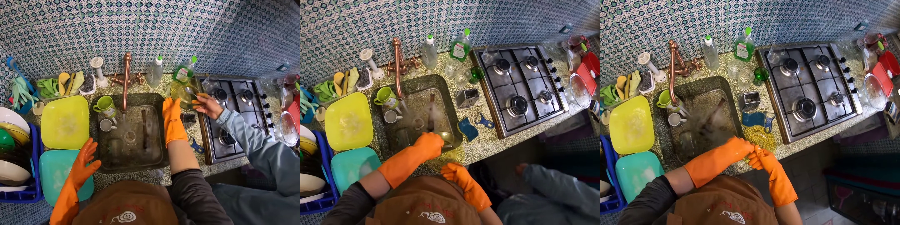


Question:  What color is the fuel tank lid i closed
Answer:  The fuel tank lid is closed and is red in color.


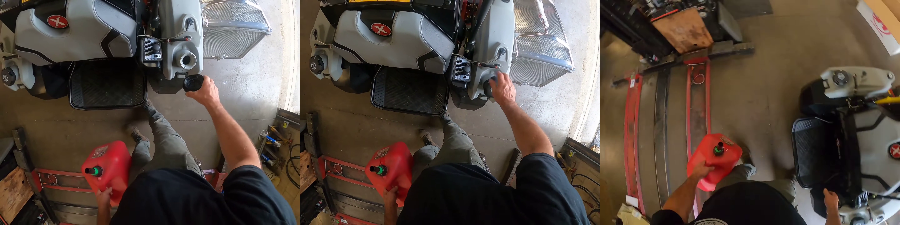


Question:  where did i put my phone?
Answer:  The video does not provide information about where the phone is placed.


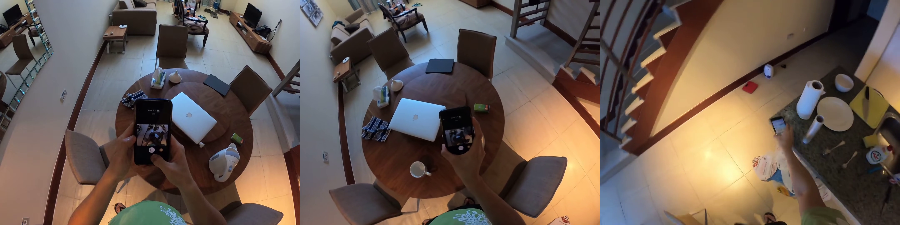


Question:  Who was with me when I pulled the lawnmower?
Answer:  A man was with me when I pulled the lawnmower.


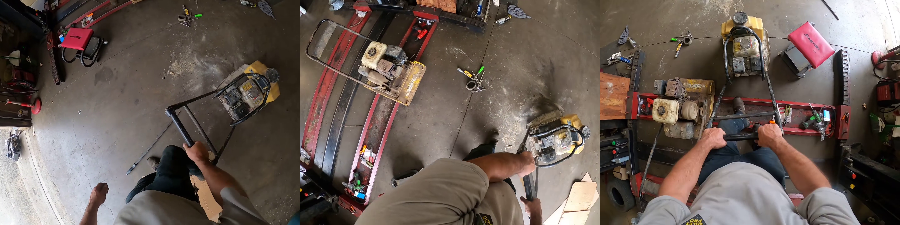


Question:  What chopping board did I wash?
Answer:  I washed a chopping board in the sink.


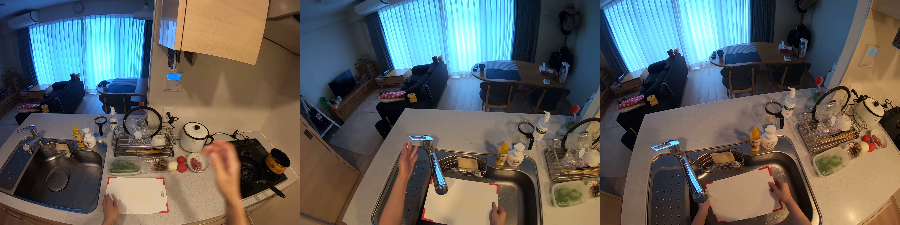


Question:  Where was the plate before I took it?
Answer:  The plate was on the top shelf of the refrigerator.


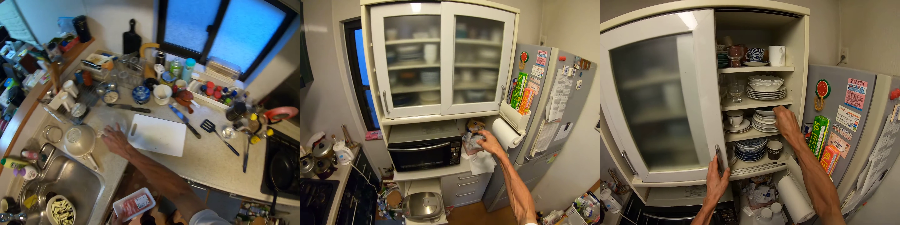


Question:  Where was the egg before I picked it?
Answer:  The egg was in the refrigerator before I picked it.


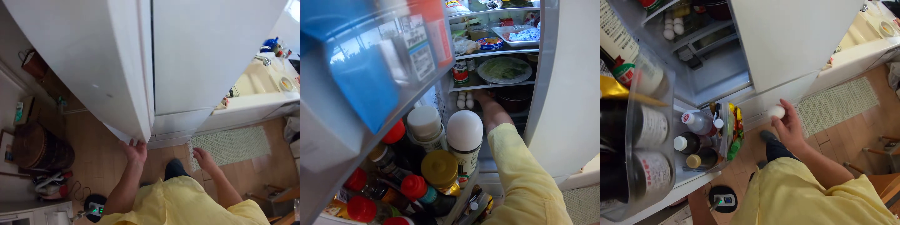


Question:  who did I talk to in  the house?
Answer:  I talked to a man in the house.


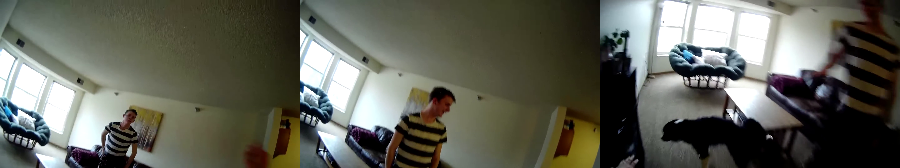


Question:  How many plates did i take from the top shelf?
Answer:  The video does not provide information on how many plates were taken from the top shelf.


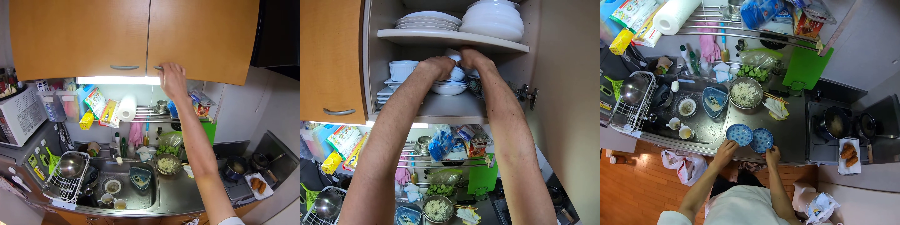


Question:  Where is round brush before picked?
Answer:  The round brush is on the floor before the woman picks it up.


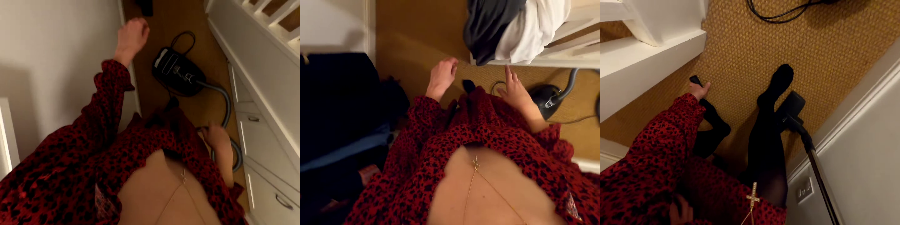


Question:  Who did I interact with when I was walking out of the clothing store. 
Answer:  When I was walking out of the clothing store, I interacted with a woman who was wearing a black shirt and a black headscarf. She was standing in front of a door and was wearing a black shirt.


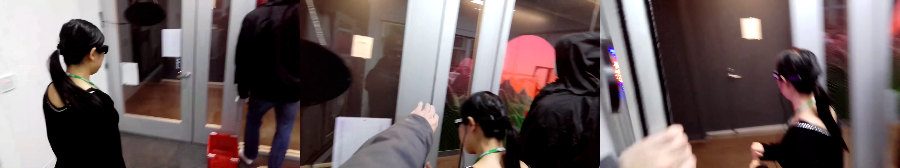


Question:  where was the phone before I picked it?
Answer:  The phone was on the table before I picked it up.


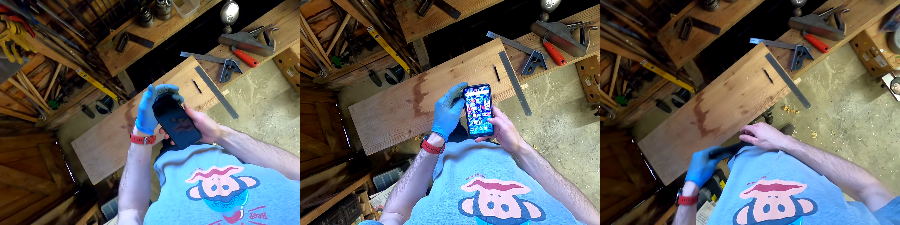


Question:  What time was displayed on my phone screen?
Answer:  The video does not provide information about the time displayed on the phone screen.


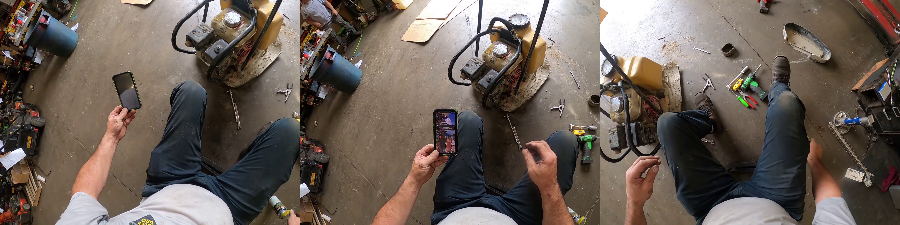


Question:  Where is the dish brush?
Answer:  The dish brush is on the sink.


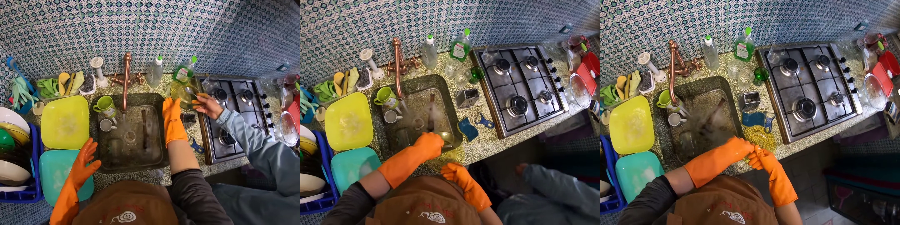


Question:  What did I put in the plate?
Answer:  I put cereal in the bowl.


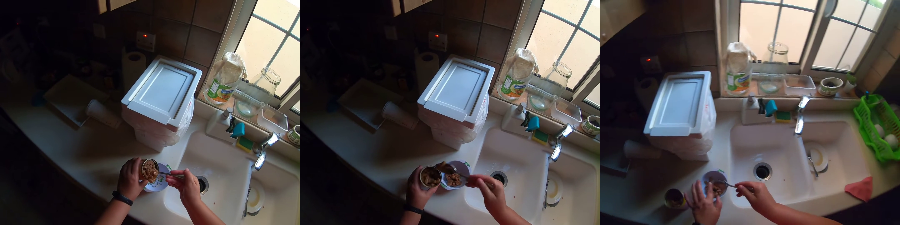


Question:  Did i leave the microwave open?
Answer:  Yes, the video shows that the microwave is left open after the man finishes cooking.


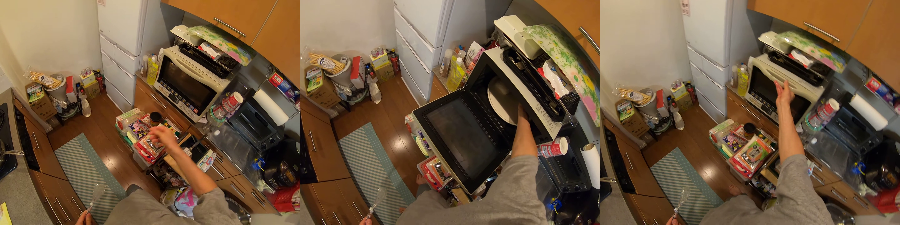


Question:  In what location did I drop the stainless ?
Answer:  I dropped the stainless steel pot on the kitchen floor.


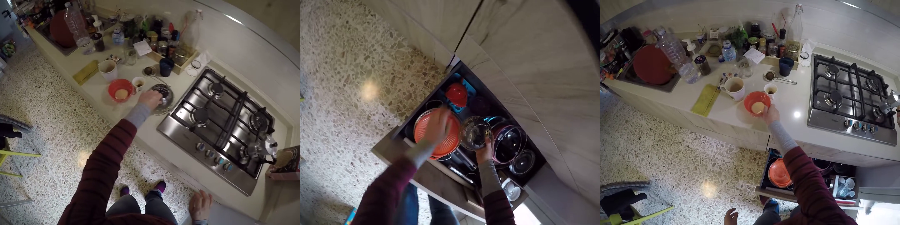


Question:  where is my phone?
Answer:  The person is holding the phone in their hand and pointing it towards the camera.


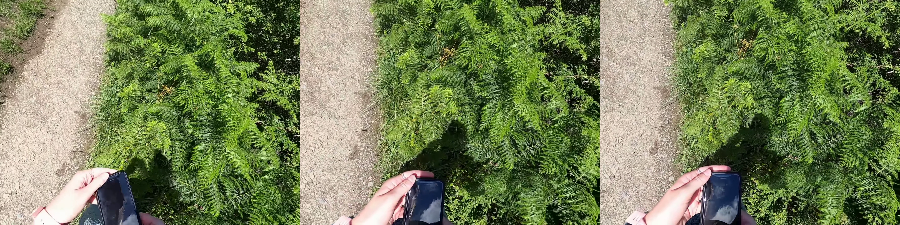


Question:  Where did I put trash?
Answer:  I put trash in a trash can.


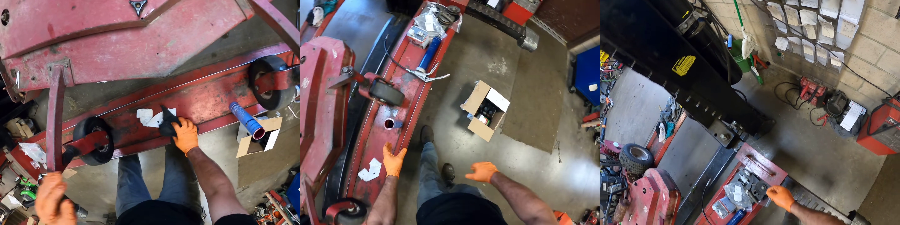


Question:  Where is phone
Answer:  The phone is on a shelf in the room.


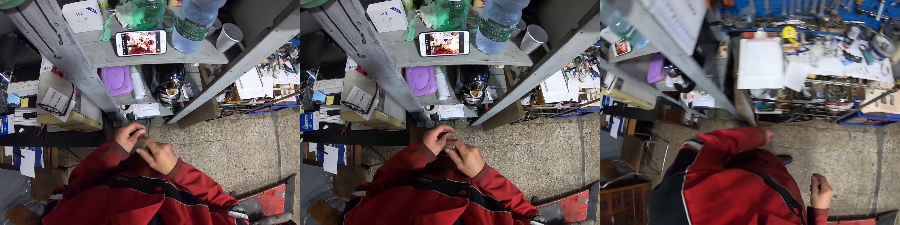


Question:  What did I pour in the frying pan?
Answer:  I poured oil in the frying pan.


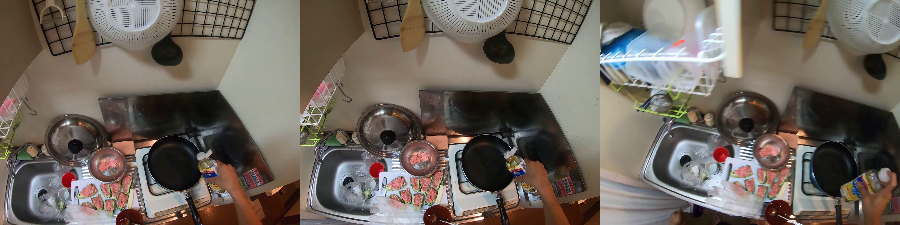


Question:  Where did I put the ham?
Answer:  I put the ham in the refrigerator.


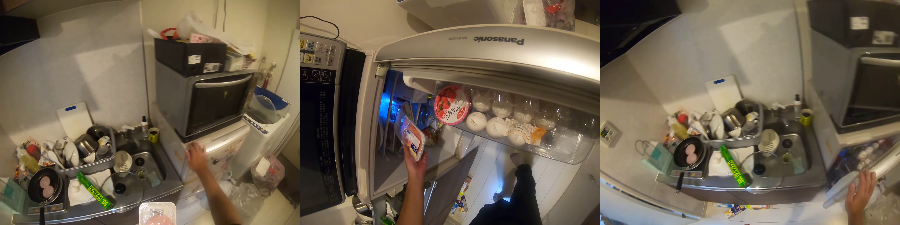


Question:  How many bottles of coke was in the pack I took?
Answer:  The pack of coke that the person took had 8 bottles.


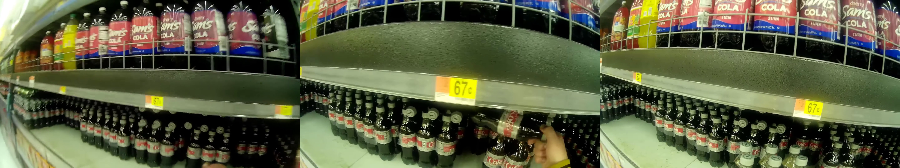


Question:  Where was the plier before I picked it?
Answer:  The plier was on the table before I picked it up.


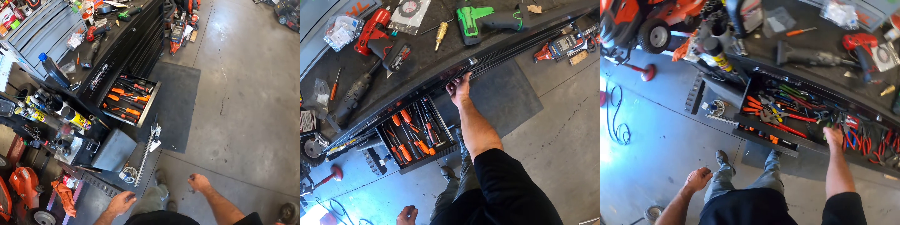


Question:  what did l take in the fridge
Answer:  L took out a bowl of food and a blue bowl from the fridge.


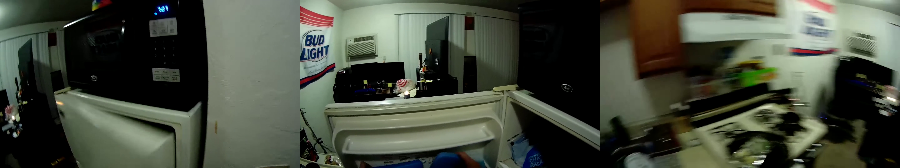


Question:  What colour is the pant I folded last?
Answer:  The pant I folded last is red.


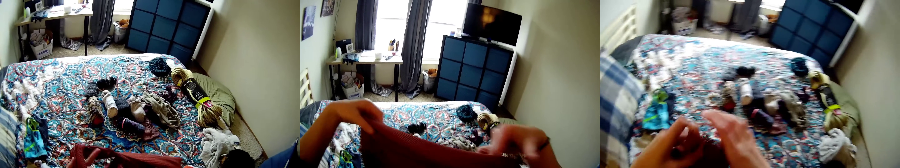


Question:  In what location did I see the jenga box first?
Answer:  The jenga box was first seen on a table in the living room.


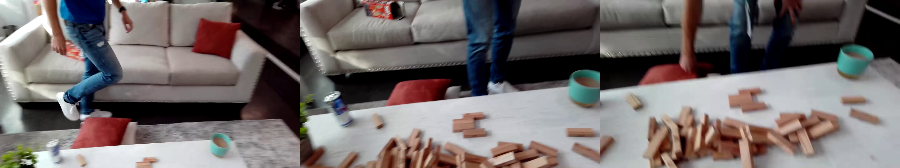


Question:  What time did i operate the machine?
Answer:  The video does not provide information about the time it took to operate the machine.


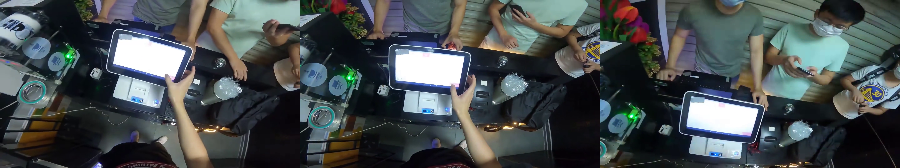


Question:  What did I throw in the bin?
Answer:  I threw a shirt in the bin.


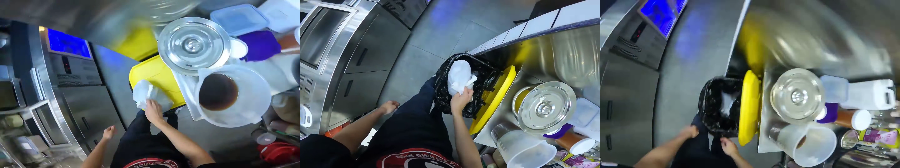


Question:  What did I drop inside the kitchen cabinet?
Answer:  I accidentally dropped a bottle of detergent inside the kitchen cabinet.


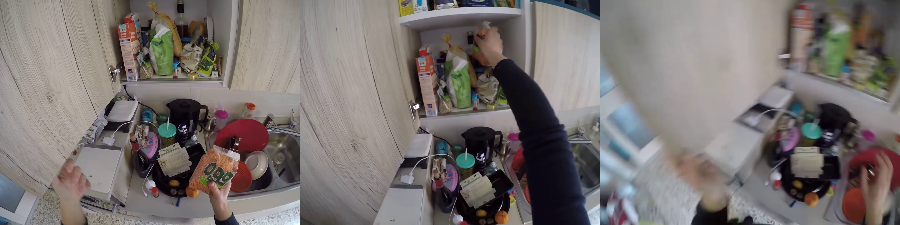


Question:  Where is the red bicycle
Answer:  The red bicycle is parked in front of a building.


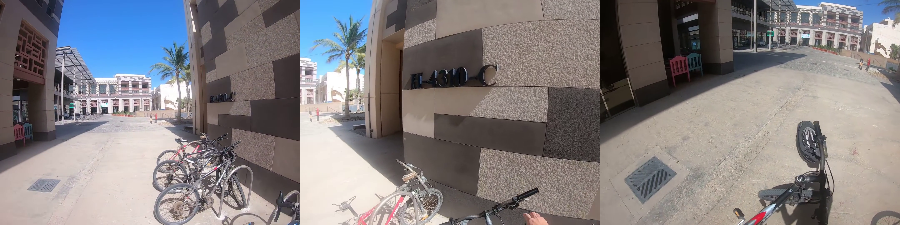


Question:  How many tools did I remove from the bag?
Answer:  I removed three tools from the bag.


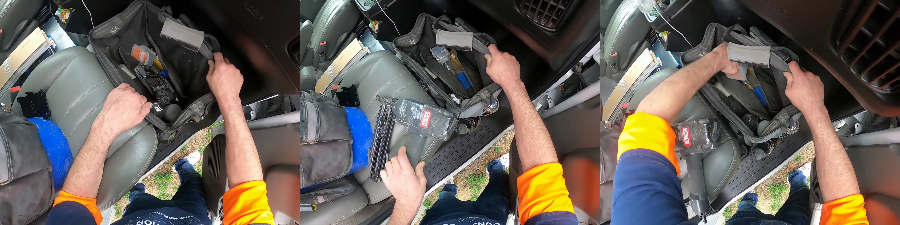


Question:  Where were the papers before I put them in the empty box?
Answer:  The papers were on the floor before the man put them in the empty box.


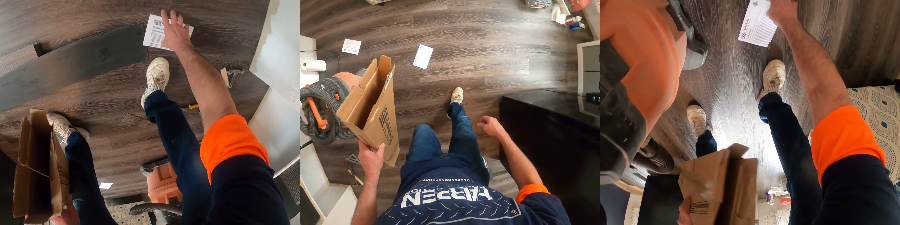


Question:  Where was the apron before I picked it?
Answer:  The apron was hanging on a hook in the kitchen before I picked it up.


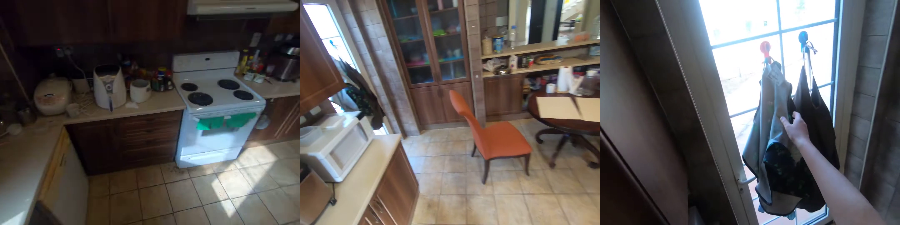


Question:  Where was can drink before I drank it?
Answer:  The man in the video is seen holding a can of drink in front of a house. He then drinks from the can and sets it down.


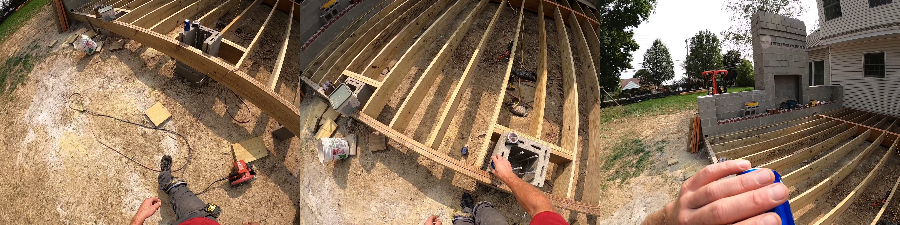


Question:  What did I put in the fridge
Answer:  I put a beer in the fridge.


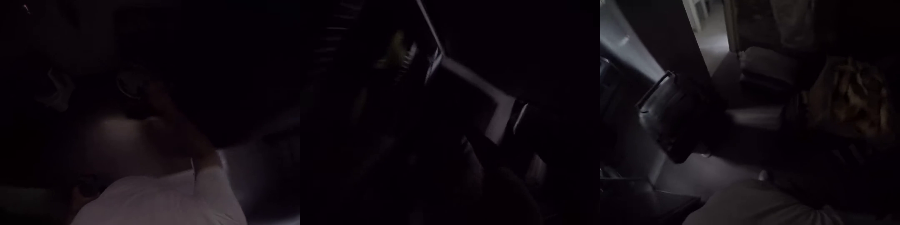


Question:  what did i put in the cooking pot?
Answer:  You put chicken and vegetables in the cooking pot.


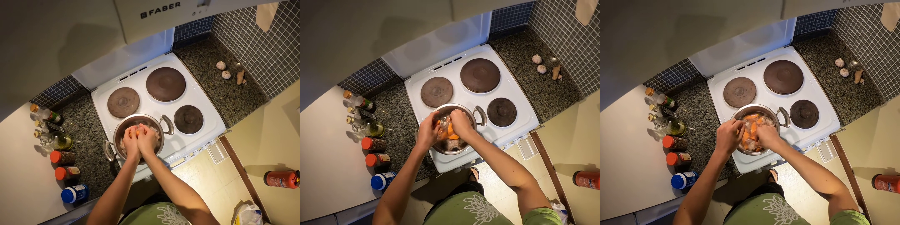


Question:  What phone did I press?
Answer:  The video does not provide information about the phone that the man is holding.


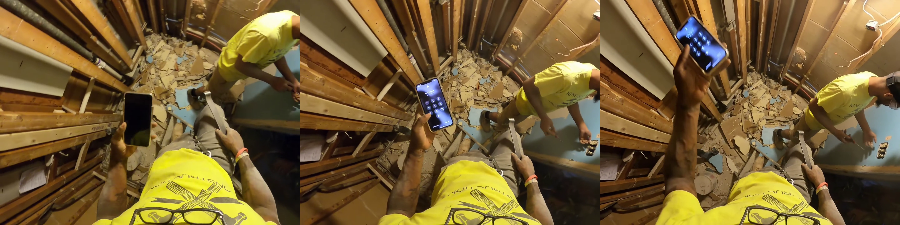


Question:  where was the refrigerator?
Answer:  The refrigerator was in a kitchen.


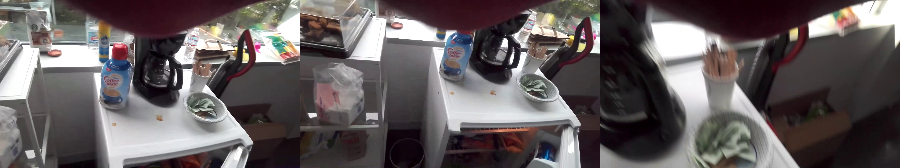


Question:  What color was the jacket hanged on the wall?
Answer:  The jacket hanged on the wall was blue in color.


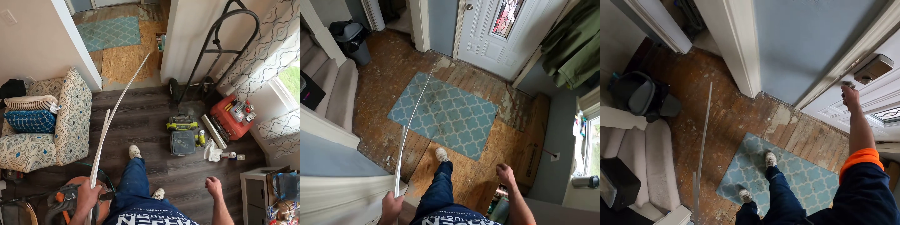


Question:  Where was the silver plier before I picked it?
Answer:  The silver plier was on the table before I picked it up.


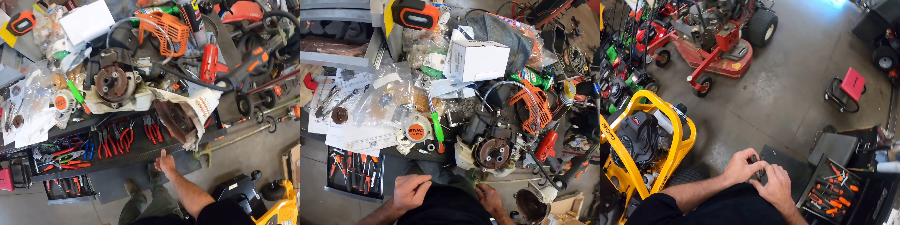


Question:  What did I put in the Oven?
Answer:  I put a plate with food in the oven.


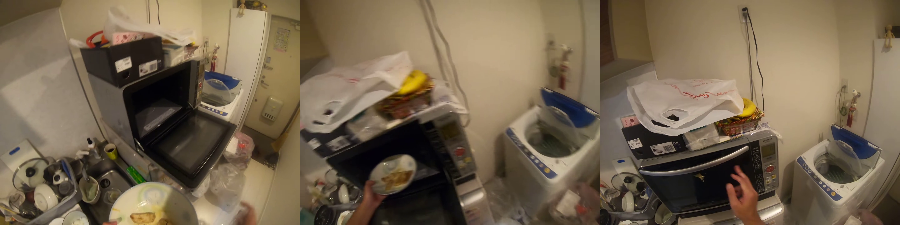


Question:  who did I talk to in the study room?
Answer:  In the study room, I talked to a man who was wearing glasses and a black shirt. He was holding a metal ball and a brush.


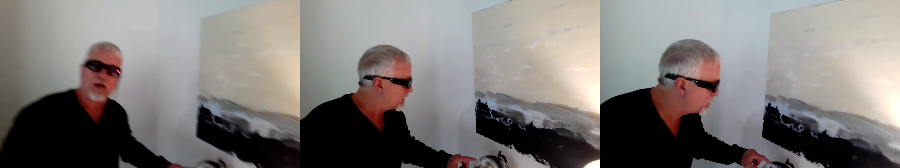


Question:  what did l put in the drawer
Answer:  L put a pack of cigarettes in the drawer.


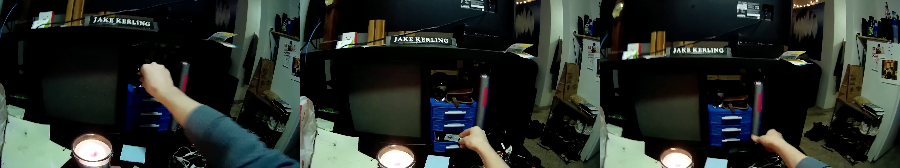


Question:  What color of shirt was the woman in the room wearing?
Answer:  The woman in the room was wearing a black shirt.


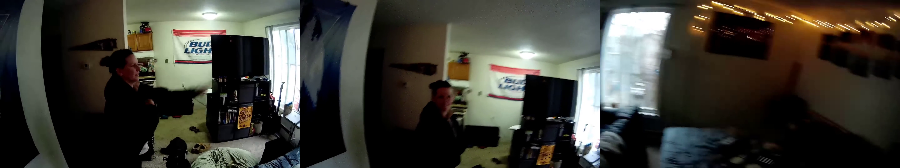


Question:  What color is the cloth i folded?
Answer:  The cloth I folded is white in color.


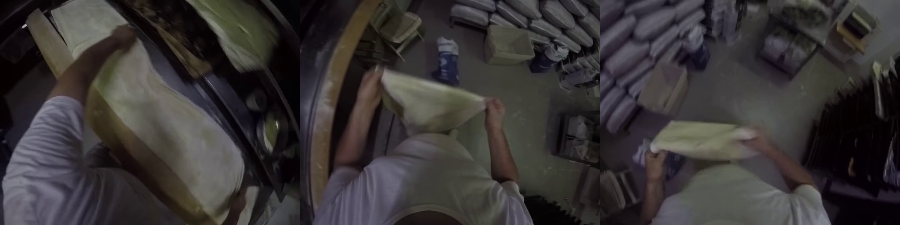


Question:  what did I put in the black dustbin?
Answer:  I put a black garbage bag in the black dustbin.


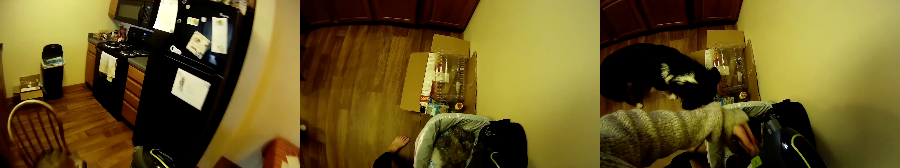


Question:  Where did I put the wire?
Answer:  I put the wire on the ladder and then on the wall.


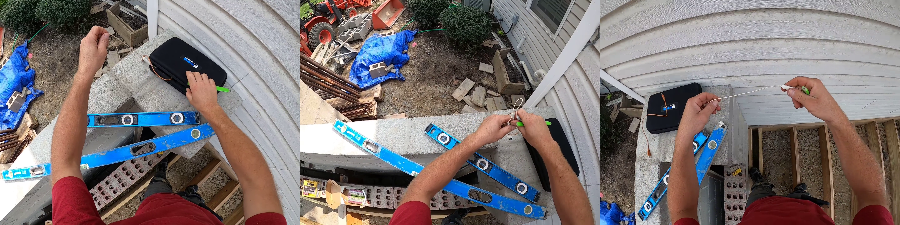


Question:  Where was the dining chair?
Answer:  The dining chair was located in the kitchen.


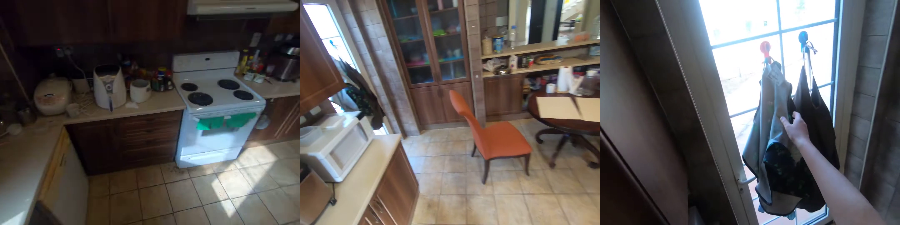


Question:  Who did I interact with when I was standing?
Answer:  When I was standing, I interacted with a man who was holding a camera.


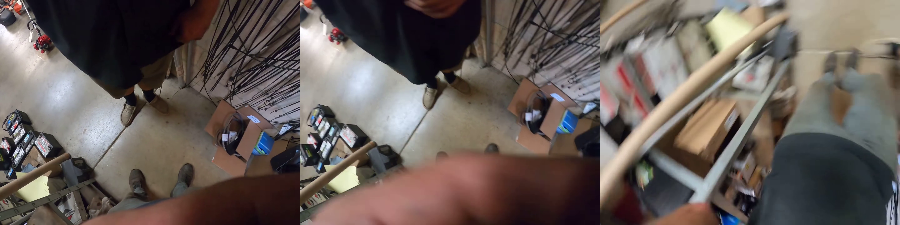

In [16]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

def extract_and_print_frames(video_path):
    # Open the video file
    cap = cv2.VideoCapture(video_path)

    # Get the total number of frames in the video
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    # Get the frame rate (frames per second)
    fps = cap.get(cv2.CAP_PROP_FPS)

    # Get the duration of the video in seconds
    duration = total_frames / fps

    # Calculate the frame indices for 0.10, 0.5, and 0.90 of the duration
    frames_to_capture = [
        int(0.10 * duration * fps),
        int(0.5 * duration * fps),
        int(0.90 * duration * fps)
    ]

    frames = []
    for frame_idx in frames_to_capture:
        # Set the video position to the specific frame
        cap.set(cv2.CAP_PROP_POS_FRAMES, frame_idx)

        # Read the frame
        ret, frame = cap.read()
        if not ret:
            print(f"Failed to capture frame at index {frame_idx}")
            continue

        # Resize the frame to a smaller size (e.g., width=200 pixels)
        height, width = frame.shape[:2]
        new_width = 300
        new_height = int((new_width / width) * height)
        resized_frame = cv2.resize(frame, (new_width, new_height))

        frames.append(resized_frame)

    # Concatenate the frames horizontally
    if frames:
        concatenated_frame = np.hstack(frames)

        # Display the concatenated frame using cv2_imshow or cv2.imshow
        try:
            from google.colab.patches import cv2_imshow
            cv2_imshow(concatenated_frame)
        except ImportError:
            cv2.imshow('Concatenated Frames', concatenated_frame)
            cv2.waitKey(0)
            cv2.destroyAllWindows()

    # Release the video capture object
    cap.release()

for d in data:
  print('\nQuestion: ', d['query'])
  print('Answer: ', d['LLaVa_answer'])
  extract_and_print_frames(d['video_segment_path'])